In [1]:
#!pip install dalex
#!pip install xgboost
import dalex as dx
from tabulate import tabulate
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
import seaborn as sns
from xgboost import XGBClassifier
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score
# classifiers
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier

import warnings
warnings.filterwarnings('ignore')

In [2]:
train_data = pd.read_csv('train_set.csv')
train_data

,OwnerAge,Gender,Area,RiskClass,VehAge,BonusClass,ClaimMade
0,18,Female,Zone 1,EV ratio <5,8,BM2,0
1,18,Female,Zone 1,EV ratio 9-12,9,BM4,0
2,18,Female,Zone 2,EV ratio <5,11,BM1,0
3,18,Female,Zone 2,EV ratio <5,12,BM1,0
4,18,Female,Zone 2,EV ratio 9-12,24,BM2,0
...,...,...,...,...,...,...,...
49624,70,Male,Zone 4,EV ratio 16-19,15,BM3,0
49625,70,Male,Zone 4,EV ratio 20-24,8,BM7,0
49626,70,Male,Zone 4,EV ratio 20-24,9,BM7,0
49627,70,Male,Zone 4,EV ratio 20-24,10,BM7,0


In [3]:
over_train = pd.read_csv('oversample_train_data.csv')
over_train

,OwnerAge,Gender,Area,RiskClass,VehAge,BonusClass,ClaimMade
0,18,Female,Zone 1,EV ratio <5,8,BM2,0
1,18,Female,Zone 1,EV ratio 9-12,9,BM4,0
2,18,Female,Zone 2,EV ratio <5,11,BM1,0
3,18,Female,Zone 2,EV ratio <5,12,BM1,0
4,18,Female,Zone 2,EV ratio 9-12,24,BM2,0
...,...,...,...,...,...,...,...
73495,26,Male,Zone 3,EV ratio 13-15,2,BM1,1
73496,32,Male,Zone 3,EV ratio 20-24,3,BM1,1
73497,27,Male,Zone 2,EV ratio 20-24,2,BM7,1
73498,59,Male,Zone 4,EV ratio 16-19,5,BM7,1


In [ ]:
test_data = pd.read_csv('test_set.csv')

X_test = test_data.drop('ClaimMade',axis = 1)

y_test = test_data['ClaimMade']

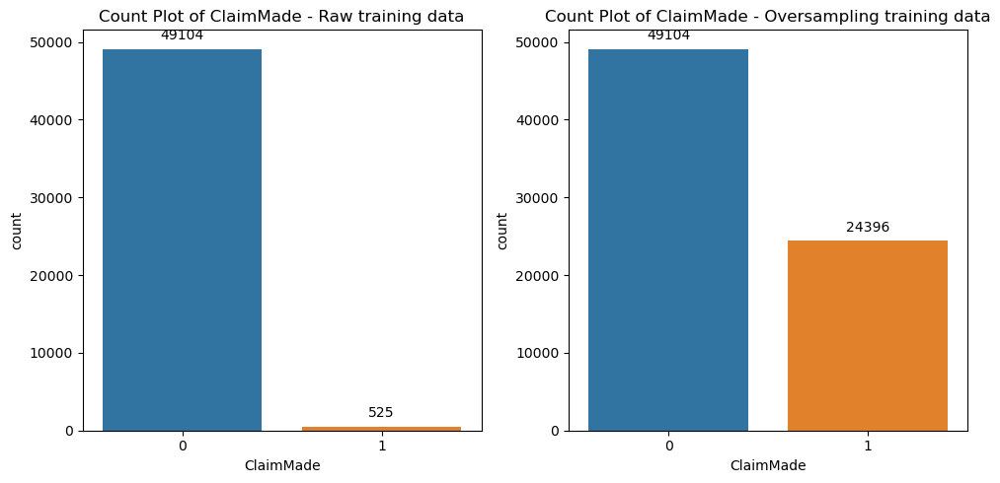

In [6]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

sns.countplot(data=train_data, x='ClaimMade', ax=axes[0])

for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.0f'), 
                     (p.get_x() + p.get_width() / 2., p.get_height()), 
                     ha = 'center', va = 'center', 
                     xytext = (0, 10), 
                     textcoords = 'offset points')

axes[0].set_title('Count Plot of ClaimMade - Raw training data')

sns.countplot(data=over_train, x='ClaimMade', ax=axes[1])

for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.0f'), 
                     (p.get_x() + p.get_width() / 2., p.get_height()), 
                     ha = 'center', va = 'center', 
                     xytext = (0, 10), 
                     textcoords = 'offset points')

axes[1].set_title('Count Plot of ClaimMade - Oversampling training data')

plt.tight_layout()

plt.savefig('comparison_oversample_with_count.png', bbox_inches='tight', pad_inches=0.1)
plt.show()

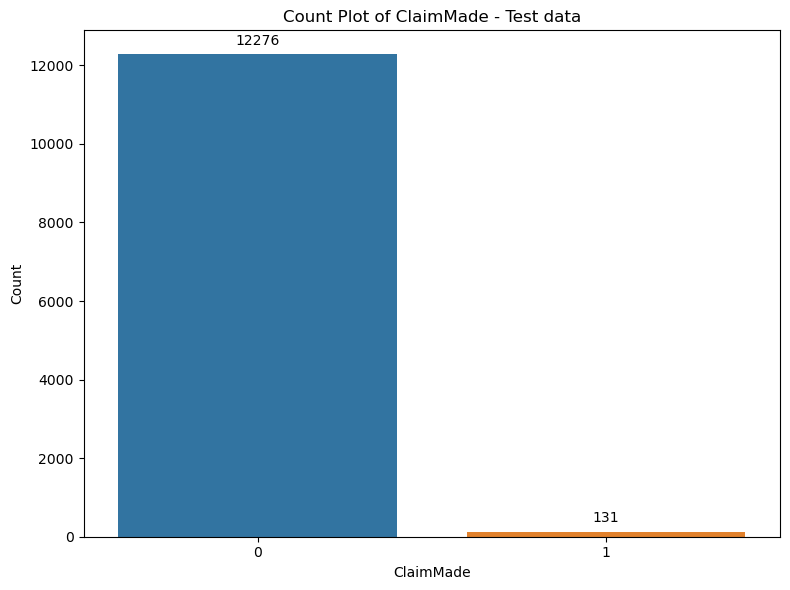

In [7]:
plt.figure(figsize=(8, 6))
ax = sns.countplot(data=test_data, x='ClaimMade')

for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                xytext=(0, 10), 
                textcoords='offset points')
    
plt.title('Count Plot of ClaimMade - Test data')
plt.xlabel('ClaimMade')
plt.ylabel('Count')

plt.tight_layout()
plt.savefig('test_data.png', bbox_inches='tight', pad_inches=0.1)
plt.show()


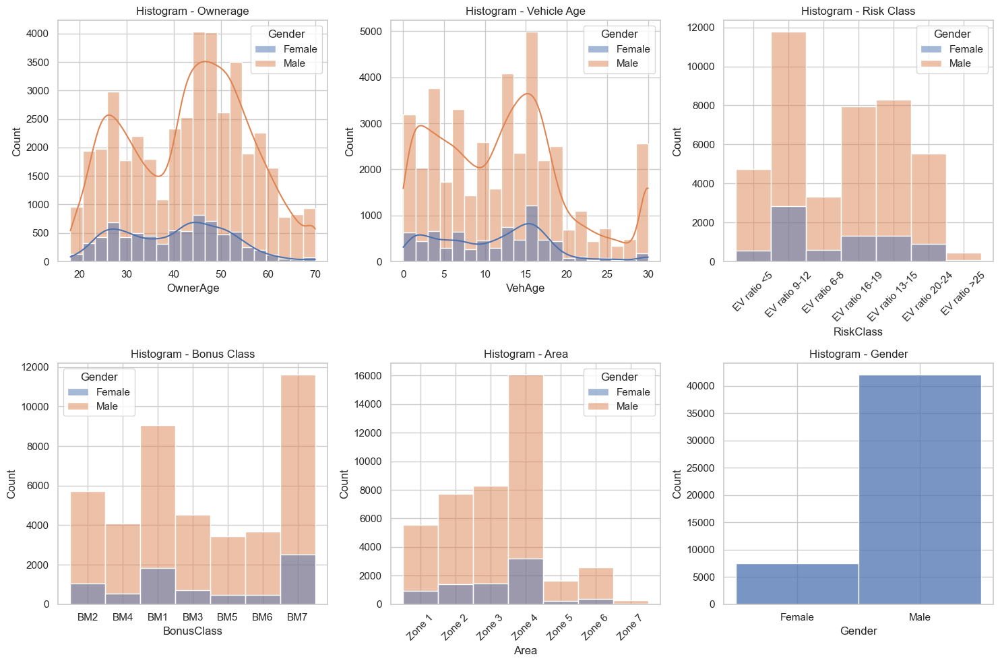

In [8]:
sns.set(style="whitegrid") 
plt.figure(figsize=(15, 10))  

plt.subplot(2, 3, 1)
sns.histplot(data=train_data, x='OwnerAge', bins=20, hue='Gender', kde=True)
plt.title('Histogram - Ownerage')

plt.subplot(2, 3, 2)
sns.histplot(data=train_data, x='VehAge', bins=20, kde=True, hue='Gender')
plt.title('Histogram - Vehicle Age')

plt.subplot(2, 3, 3)
sns.histplot(data=train_data, x='RiskClass', bins=20,  hue='Gender')
plt.title('Histogram - Risk Class')
plt.xticks(rotation=45)

plt.subplot(2, 3, 4)
sns.histplot(data=train_data, x='BonusClass', bins=20, hue='Gender')
plt.title('Histogram - Bonus Class')

plt.subplot(2, 3, 5)
sns.histplot(data=train_data, x='Area', bins=20,  hue='Gender')
plt.title('Histogram - Area')
plt.xticks(rotation=45)

plt.subplot(2, 3, 6)
sns.histplot(data=train_data, x='Gender', bins=10)
plt.title('Histogram - Gender')

plt.tight_layout()
plt.savefig('raw_train_data_distribution.png', bbox_inches='tight', pad_inches=0.1)
plt.show()


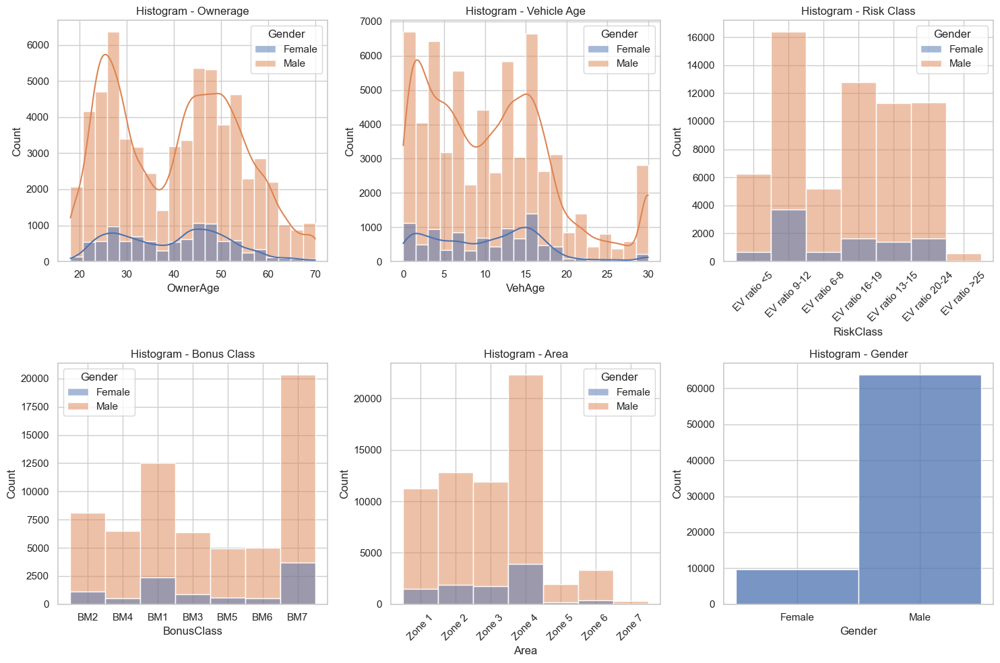

In [9]:
sns.set(style="whitegrid") 
plt.figure(figsize=(15, 10))  

plt.subplot(2, 3, 1)
sns.histplot(data=over_train, x='OwnerAge', bins=20, hue='Gender', kde=True)
plt.title('Histogram - Ownerage')

plt.subplot(2, 3, 2)
sns.histplot(data=over_train, x='VehAge', bins=20, kde=True, hue='Gender')
plt.title('Histogram - Vehicle Age')

plt.subplot(2, 3, 3)
sns.histplot(data=over_train, x='RiskClass', bins=20,  hue='Gender')
plt.title('Histogram - Risk Class')
plt.xticks(rotation=45)

plt.subplot(2, 3, 4)
sns.histplot(data=over_train, x='BonusClass', bins=20, hue='Gender')
plt.title('Histogram - Bonus Class')

plt.subplot(2, 3, 5)
sns.histplot(data=over_train, x='Area', bins=20,  hue='Gender')
plt.title('Histogram - Area')
plt.xticks(rotation=45)

plt.subplot(2, 3, 6)
sns.histplot(data=over_train, x='Gender', bins=10)
plt.title('Histogram - Gender')

plt.tight_layout()
plt.savefig('oversample_train_data.png', bbox_inches='tight', pad_inches=0.1)
plt.show()


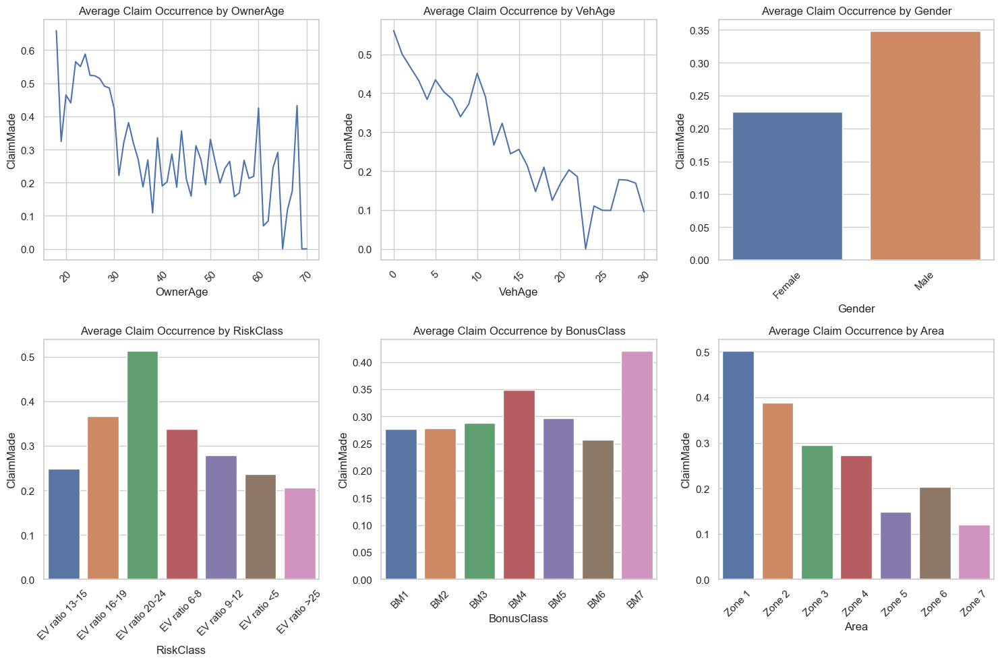

In [10]:
sns.set(style="whitegrid") 
predictor_variables = [ 'OwnerAge', 'VehAge','Gender', 'RiskClass', 'BonusClass', 'Area']

plt.figure(figsize=(15, 10))

for i, variable in enumerate(predictor_variables, 1):
    plt.subplot(2, 3, i)
    
    average_claim = over_train.groupby(variable)['ClaimMade'].mean().reset_index()
    
    if over_train[variable].dtype == 'object':  # For categorical variables
        sns.barplot(data=average_claim, x=variable, y='ClaimMade')
    else:  
        sns.lineplot(data=over_train, x=variable, y='ClaimMade', ci=None)
    
    plt.title(f'Average Claim Occurrence by {variable}')
    
    plt.xticks(rotation=45)

plt.tight_layout()
plt.savefig('average claim oversample train data.png', bbox_inches='tight', pad_inches=0.1)
plt.show()


In [11]:
X_train = over_train.drop('ClaimMade',axis = 1)

y_train = over_train['ClaimMade']

In [12]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
# classifiers
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC


categorical_features = ['Gender', 'Area', 'RiskClass', 'BonusClass']
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

numerical_features = ["OwnerAge", "VehAge"]
numerical_transformer = Pipeline(steps=[
    ('scale', StandardScaler())
])

preprocessor = ColumnTransformer(transformers=[
        ('cat', categorical_transformer, categorical_features),
        ('num', numerical_transformer, numerical_features)
])

clf_logreg = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(penalty = None))
])

clf_forest = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(n_estimators=100, min_samples_split = 10, max_depth=10, random_state=123))
])

clf_gbm = Pipeline(steps=[
    ('preprocessor', preprocessor),  
    ('classifier', GradientBoostingClassifier(
    ))
])

clf_svm = Pipeline(steps=[
    ('preprocessor', preprocessor), 
    ('classifier', SVC(kernel='rbf', C=1.0, gamma='scale', random_state=123))
])


clf_logreg.fit(X_train, y_train)
clf_forest.fit(X_train, y_train)
clf_gbm.fit(X_train, y_train)
clf_svm.fit(X_train,y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('cat',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Gender', 'Area',
                                                   'RiskClass', 'BonusClass']),
                                                 ('num',
                                                  Pipeline(steps=[('scale',
                                                                   StandardScaler())]),
                                                  ['OwnerAge', 'VehAge'])])),
                ('classifier', SVC(random_state=123))])

In [13]:
import dalex as dx
dx.__version__

'1.6.0'

In [40]:
exp_logreg = dx.Explainer(clf_logreg, X_train, y_train)
exp_forest = dx.Explainer(clf_forest, X_train, y_train, verbose=False)
exp_svm = dx.Explainer(clf_svm, X_train, y_train, verbose=False)
exp_gbm = dx.Explainer(clf_gbm, X_train, y_train, verbose=False)

Preparation of a new explainer is initiated

  -> data              : 73500 rows 6 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 73500 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x142903ec0> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.00595, mean = 0.332, max = 0.93
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.93, mean = -3.87e-06, max = 0.976
  -> model_info        : package sklearn

A new explainer has been created!


In [41]:
concatenated_df = pd.concat([exp.model_performance().result for exp in [exp_logreg, exp_forest, exp_svm, exp_gbm]])
concatenated_df

,recall,precision,f1,accuracy,auc
LogisticRegression,0.467946,0.641384,0.541107,0.736558,0.773422
RandomForestClassifier,0.691384,0.848996,0.762126,0.856748,0.942913
SVC,0.784760,0.736941,0.760099,0.835578,0.822793
GradientBoostingClassifier,0.548082,0.698845,0.614349,0.771605,0.834548


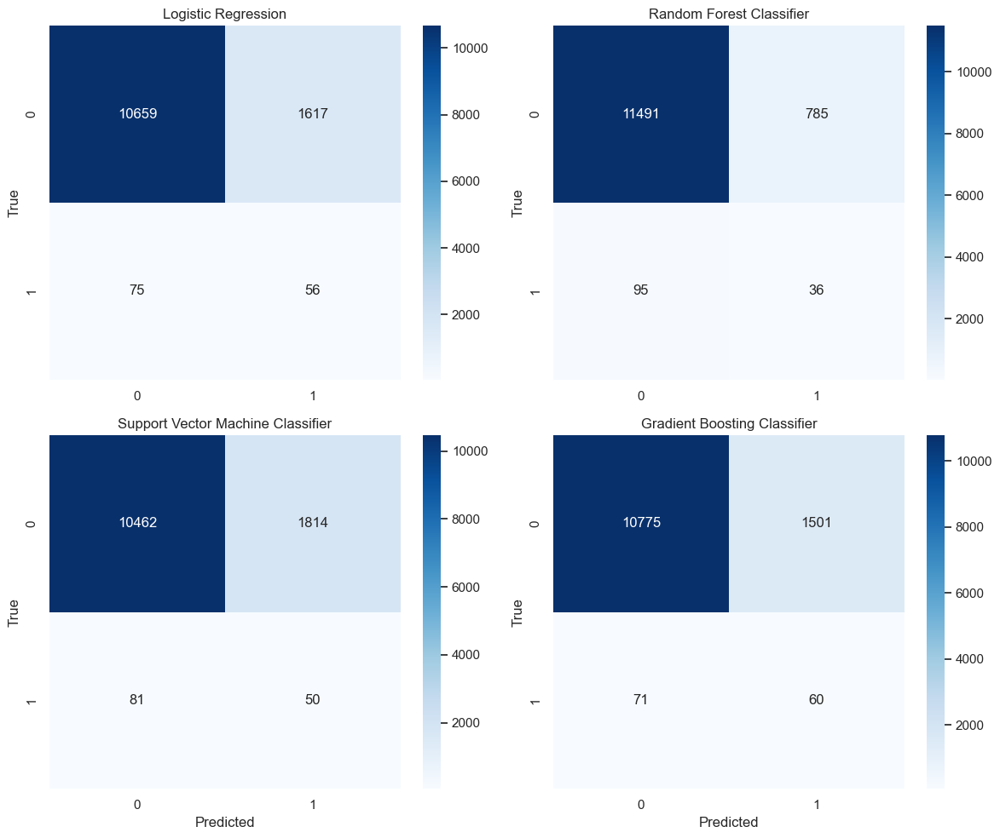

In [16]:
y_pred_test_log = clf_logreg.predict(X_test)
y_pred_test_rf = clf_forest.predict(X_test)
y_pred_test_gbm = clf_gbm.predict(X_test)
y_pred_test_svm = clf_svm.predict(X_test)


conf_matrix_rf = confusion_matrix(y_test, y_pred_test_rf)
conf_matrix_log = confusion_matrix(y_test, y_pred_test_log)
conf_matrix_gbm = confusion_matrix(y_test, y_pred_test_gbm)
conf_matrix_svm = confusion_matrix(y_test, y_pred_test_svm)


class_labels = ['0', '1']  

conf_matrix_log = confusion_matrix(y_test, y_pred_test_log)
conf_matrix_rf = confusion_matrix(y_test, y_pred_test_rf)
conf_matrix_svm = confusion_matrix(y_test, y_pred_test_svm)
conf_matrix_gbm = confusion_matrix(y_test, y_pred_test_gbm)

plt.figure(figsize=(12, 10))

# Logistic Regression
plt.subplot(2, 2, 1)
sns.heatmap(conf_matrix_log, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.ylabel('True')
plt.title('Logistic Regression')

# Random Forest Classifier
plt.subplot(2, 2, 2)
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.ylabel('True')
plt.title('Random Forest Classifier')

# Support Vector Classifier
plt.subplot(2, 2, 3)
sns.heatmap(conf_matrix_svm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Support Vector Machine Classifier')

# Gradient Boosting Classifier
plt.subplot(2, 2, 4)
sns.heatmap(conf_matrix_gbm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Gradient Boosting Classifier')

plt.tight_layout()
plt.savefig('Confusion matrix.png', bbox_inches='tight', pad_inches=0.1)
plt.show()

In [46]:
import plotly.graph_objects as go
from sklearn.metrics import roc_curve, auc
from plotly.subplots import make_subplots

y_score_logreg_train = exp_logreg.predict(X_train)
y_score_rf_train = exp_forest.predict(X_train)
y_score_gbm_train = exp_gbm.predict(X_train)
y_score_svc_train = exp_svm.predict(X_train)

fpr_logreg_train, tpr_logreg_train, _ = roc_curve(y_train, y_score_logreg_train)
fpr_rf_train, tpr_rf_train, _ = roc_curve(y_train, y_score_rf_train)
fpr_gbm_train, tpr_gbm_train, _ = roc_curve(y_train, y_score_gbm_train)
fpr_svc_train, tpr_svc_train, _ = roc_curve(y_train, y_score_svc_train)

auc_logreg_train = auc(fpr_logreg_train, tpr_logreg_train)
auc_rf_train = auc(fpr_rf_train, tpr_rf_train)
auc_gbm_train = auc(fpr_gbm_train, tpr_gbm_train)
auc_svc_train = auc(fpr_svc_train, tpr_svc_train)

fig = make_subplots(rows=1, cols=2, subplot_titles=("ROC Curves for Train Data", "ROC Curves for Test Data"))

fig.add_trace(go.Scatter(x=fpr_logreg_train, y=tpr_logreg_train, mode='lines', name=f'Logistic Regression (AUC={auc_logreg_train:.4f})'), row=1, col=1)
fig.add_trace(go.Scatter(x=fpr_rf_train, y=tpr_rf_train, mode='lines', name=f'Random Forest (AUC={auc_rf_train:.4f})'), row=1, col=1)
fig.add_trace(go.Scatter(x=fpr_gbm_train, y=tpr_gbm_train, mode='lines', name=f'GBM (AUC={auc_gbm_train:.4f})'), row=1, col=1)
fig.add_trace(go.Scatter(x=fpr_svc_train, y=tpr_svc_train, mode='lines', name=f'SVM (AUC={auc_svc_train:.4f})'), row=1, col=1)

fig.add_shape(type='line', line=dict(dash='dash'), x0=0, x1=1, y0=0, y1=1, row=1, col=1)

fig.add_trace(go.Scatter(x=fpr_logreg, y=tpr_logreg, mode='lines', name=f'Logistic Regression (AUC={auc_logreg:.4f})'), row=1, col=2)
fig.add_trace(go.Scatter(x=fpr_rf, y=tpr_rf, mode='lines', name=f'Random Forest (AUC={auc_rf:.4f})'), row=1, col=2)
fig.add_trace(go.Scatter(x=fpr_gbm, y=tpr_gbm, mode='lines', name=f'GBM (AUC={auc_gbm:.4f})'), row=1, col=2)
fig.add_trace(go.Scatter(x=fpr_svc, y=tpr_svc, mode='lines', name=f'SVM (AUC={auc_svc:.4f})'), row=1, col=2)

fig.add_shape(type='line', line=dict(dash='dash'), x0=0, x1=1, y0=0, y1=1, row=1, col=2)

fig.update_layout(
    title_text="ROC Curves for Different Models",
    width=1200,
    height=600
)

fig.show()


In [15]:
exp_logreg.model_parts().plot(objects=[exp_forest.model_parts(),exp_gbm.model_parts(), exp_svm.model_parts()])

In [79]:
pd_rf = exp_forest.model_profile(variables = ['OwnerAge', 'VehAge'] )
pd_logreg = exp_logreg.model_profile(variables = ['OwnerAge', 'VehAge'])
pd_svm = exp_svm.model_profile(variables = ['OwnerAge', 'VehAge'])
pd_gbm = exp_gbm.model_profile(variables = ['OwnerAge', 'VehAge'])

Calculating ceteris paribus: 100%|██████████████████████| 2/2 [00:00<00:00, 25.33it/s]


In [80]:
# Partial-dependence Profiles for four models
pd_rf.plot(objects = [pd_logreg,pd_svm,pd_gbm])

In [81]:
# Partial-dependence Profiles for RF model
pd_forest.plot()

In [82]:
# CP Profiles of RF model 
pd_forest.plot(geom = 'profiles')

In [83]:
# Categorical variables profiles 
pd_gbm = exp_forest.model_profile(variable_type = 'categorical')
pd_gbm.plot()

Calculating ceteris paribus: 100%|██████████████████████| 6/6 [00:00<00:00, 23.20it/s]


In [84]:
# Group by Gender, can conclude some differences between Male and Female.
pd_rf = exp_forest.model_profile(groups = 'Gender')
pd_rf.plot()

Calculating ceteris paribus: 100%|██████████████████████| 6/6 [00:00<00:00, 51.24it/s]


In [85]:
# Group by Area
pd_rf = exp_forest.model_profile(groups = 'Area')
pd_rf.plot()

Calculating ceteris paribus: 100%|██████████████████████| 6/6 [00:00<00:00, 50.34it/s]


In [86]:
# Group by Area
pd_rf = exp_forest.model_profile(groups = 'BonusClass')
pd_rf.plot()

Calculating ceteris paribus: 100%|██████████████████████| 6/6 [00:00<00:00, 50.48it/s]


In [87]:
# Partcial-dependence, Local-dependence and accumulated-local profiles for RF
pd_rf = exp_forest.model_profile(type = "partial" )
pd_rf.result['_label_'] = 'PD profiles'

ld_rf = exp_forest.model_profile(type = 'conditional')
ld_rf.result['_label_'] = 'LD profiles'

al_rf = exp_forest.model_profile(type = 'accumulated')
al_rf.result['_label_'] = 'AL profiles'

al_rf.plot(objects = [ld_rf,pd_rf])

Calculating accumulated dependency: 100%|███████████████| 2/2 [00:00<00:00, 38.02it/s]


In [88]:
test_data[(test_data['Gender'] == 'Male') & 
                   (test_data['BonusClass'] == 'BM7') & 
                   (test_data['Area'] == 'Zone 4') & 
                   (test_data['ClaimMade'] == 1)]

selected_rows= test_data.iloc[1675]
selected_rows = selected_rows.drop('ClaimMade')
selected_rows

OwnerAge                 26
Gender                 Male
Area                 Zone 4
RiskClass     EV ratio 9-12
VehAge                    2
BonusClass              BM7
Name: 1675, dtype: object

In [89]:
instance = pd.DataFrame({'OwnerAge'   : [26],
                       'Gender'     : ['Female'],
                       'Area'   : ['Zone 4'],
                       'RiskClass': ['EV ratio 9-12'],
                       'VehAge'    : [2],
                       'BonusClass'   : ['BM7']},
                      index = ['selected_instance'])

In [90]:
exp_forest.predict_parts(instance, type = 'break_down', 
                         order = np.array(['OwnerAge', 'VehAge', 'Gender','Area','BonusClass','RiskClass'])).plot()

In [91]:
exp_forest.predict_parts(instance, type = 'break_down', 
                         order = np.array(['Area','Gender','OwnerAge','VehAge','BonusClass','RiskClass'
            ])).plot()

In [92]:
interaction = exp_forest.predict_parts(instance, 
                type = 'break_down_interactions', interaction_preference = 10)
interaction.result

,variable_name,variable_value,variable,cumulative,contribution,sign,position,label
0,intercept,,intercept,0.332422,0.332422,1.0,4,RandomForestClassifier
1,Gender:OwnerAge,Female:26.0,Gender:OwnerAge = Female:26.0,0.152367,-0.180056,-1.0,3,RandomForestClassifier
2,VehAge:RiskClass,2.0:EV ratio 9-12,VehAge:RiskClass = 2.0:EV ratio 9-12,0.211244,0.058877,1.0,2,RandomForestClassifier
3,BonusClass:Area,BM7:Zone 4,BonusClass:Area = BM7:Zone 4,0.171961,-0.039283,-1.0,1,RandomForestClassifier
4,,,prediction,0.171961,0.171961,1.0,0,RandomForestClassifier


In [54]:
interaction.plot()

In [74]:
shapley = exp_forest.predict_parts(instance, type = 'shap')
shapley.result

,variable,contribution,variable_name,variable_value,sign,label,B
0,RiskClass = EV ratio 9-12,-0.042251,RiskClass,EV ratio 9-12,-1.0,GradientBoostingClassifier,1
1,OwnerAge = 26.0,0.105198,OwnerAge,26,1.0,GradientBoostingClassifier,1
2,VehAge = 2.0,0.157752,VehAge,2,1.0,GradientBoostingClassifier,1
3,Area = Zone 4,-0.053974,Area,Zone 4,-1.0,GradientBoostingClassifier,1
4,Gender = Female,-0.239125,Gender,Female,-1.0,GradientBoostingClassifier,1
...,...,...,...,...,...,...,...
1,VehAge = 2.0,0.108712,VehAge,2,1.0,GradientBoostingClassifier,0
2,OwnerAge = 26.0,0.073626,OwnerAge,26,1.0,GradientBoostingClassifier,0
3,BonusClass = BM7,0.064019,BonusClass,BM7,1.0,GradientBoostingClassifier,0
4,Area = Zone 4,-0.046603,Area,Zone 4,-1.0,GradientBoostingClassifier,0


In [75]:
shapley.plot()

In [93]:
cp_instance = exp_forest.predict_profile(instance)
cp_instance.result

Calculating ceteris paribus: 100%|█████████████████████| 6/6 [00:00<00:00, 144.93it/s]


,OwnerAge,Gender,Area,RiskClass,VehAge,BonusClass,_original_,_yhat_,_vname_,_ids_,_label_
selected_instance,18.00,Female,Zone 4,EV ratio 9-12,2.0,BM7,26,0.143903,OwnerAge,selected_instance,RandomForestClassifier
selected_instance,18.52,Female,Zone 4,EV ratio 9-12,2.0,BM7,26,0.152470,OwnerAge,selected_instance,RandomForestClassifier
selected_instance,19.04,Female,Zone 4,EV ratio 9-12,2.0,BM7,26,0.152470,OwnerAge,selected_instance,RandomForestClassifier
selected_instance,19.56,Female,Zone 4,EV ratio 9-12,2.0,BM7,26,0.143759,OwnerAge,selected_instance,RandomForestClassifier
selected_instance,20.08,Female,Zone 4,EV ratio 9-12,2.0,BM7,26,0.143759,OwnerAge,selected_instance,RandomForestClassifier
...,...,...,...,...,...,...,...,...,...,...,...
selected_instance,26.00,Female,Zone 4,EV ratio 9-12,2.0,BM1,BM7,0.094788,BonusClass,selected_instance,RandomForestClassifier
selected_instance,26.00,Female,Zone 4,EV ratio 9-12,2.0,BM3,BM7,0.115437,BonusClass,selected_instance,RandomForestClassifier
selected_instance,26.00,Female,Zone 4,EV ratio 9-12,2.0,BM5,BM7,0.118091,BonusClass,selected_instance,RandomForestClassifier
selected_instance,26.00,Female,Zone 4,EV ratio 9-12,2.0,BM6,BM7,0.090147,BonusClass,selected_instance,RandomForestClassifier


In [94]:
cp_instance.plot()

In [95]:
cp_instance = exp_forest.predict_profile(instance)
cp_instance.plot(variable_type = 'categorical')

Calculating ceteris paribus: 100%|█████████████████████| 6/6 [00:00<00:00, 137.66it/s]


In [31]:
cp_instance_log = exp_logreg.predict_profile(instance)
cp_instance_svm = exp_svm.predict_profile(instance)
cp_instance_gbm = exp_gbm.predict_profile(instance)

cp_instance.plot(objects = [cp_instance_log, cp_instance_svm, cp_instance_gbm])

Calculating ceteris paribus: 100%|█████████████████| 6/6 [00:00<00:00, 520.43it/s]


In [33]:
compare_instance_gender = test_data[(test_data['Gender'] == 'Male')  & (test_data['OwnerAge'] == 26)  & (test_data['BonusClass'] == 'BM7')]
compare_instance_gender = test_data.iloc[1675]
compare_instance_gender = compare_instance_gender.drop('ClaimMade')
compare_instance_gender

OwnerAge                 26
Gender                 Male
Area                 Zone 4
RiskClass     EV ratio 9-12
VehAge                    2
BonusClass              BM7
Name: 1675, dtype: object

In [35]:
test_data[(test_data['Gender'] == 'Female')  & (test_data['OwnerAge'] == 40)  &
                                  (test_data['BonusClass'] == 'BM7')]
compare_instance_area = test_data.iloc[4666]
compare_instance_area = compare_instance_area.drop('ClaimMade')
compare_instance_area

OwnerAge                 40
Gender               Female
Area                 Zone 4
RiskClass     EV ratio 9-12
VehAge                    2
BonusClass              BM7
Name: 4666, dtype: object

In [36]:
compare_instance_a = test_data[(test_data['Gender'] == 'Female')  & (test_data['OwnerAge'] == 26)  & (test_data['BonusClass'] == 'BM7')]
compare_instance_a = test_data.iloc[1490]
compare_instance_a = compare_instance_a.drop('ClaimMade')
compare_instance_a

OwnerAge                  26
Gender                Female
Area                  Zone 3
RiskClass     EV ratio 16-19
VehAge                    18
BonusClass               BM7
Name: 1490, dtype: object

In [59]:

exp_forest.predict_parts(instance, type="shap", label = "Selected Instance").plot([exp_forest.predict_parts(compare_instance_gender, type="shap", label = "Male"),
                                                                                   exp_forest.predict_parts(compare_instance_area, type="shap", label = "OwnerAge = 40"),
                                                                               exp_forest.predict_parts(compare_instance_a, type="shap", label = "VehAge = 18")])
                                                                                 